<a href="https://colab.research.google.com/github/sumanth-botlagunta/computer_vision_1/blob/main/computer_vision_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# COMPUTER VISION PROGRAMMING ASSIGNMENT


---
NAME: **SUMANTH BOTLAGUNTA**  
ROLL NO: **611981**




**Reading and Displaying the Image**

---



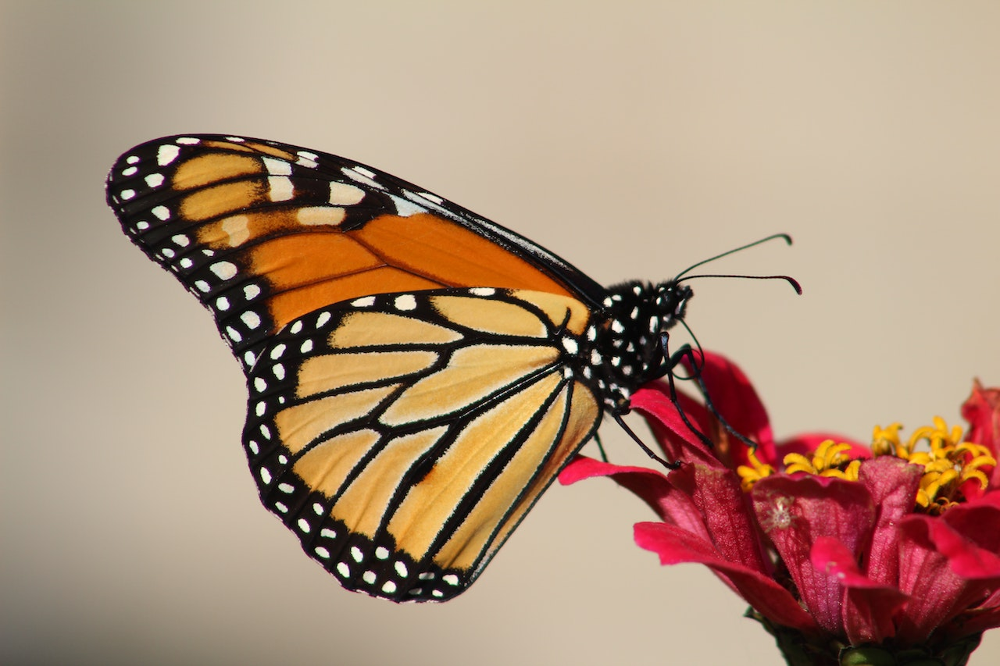

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

image = cv2.imread('butterfly_medium.jpg')
cv2_imshow( image)

**Displaying color channels of image seperately**

---



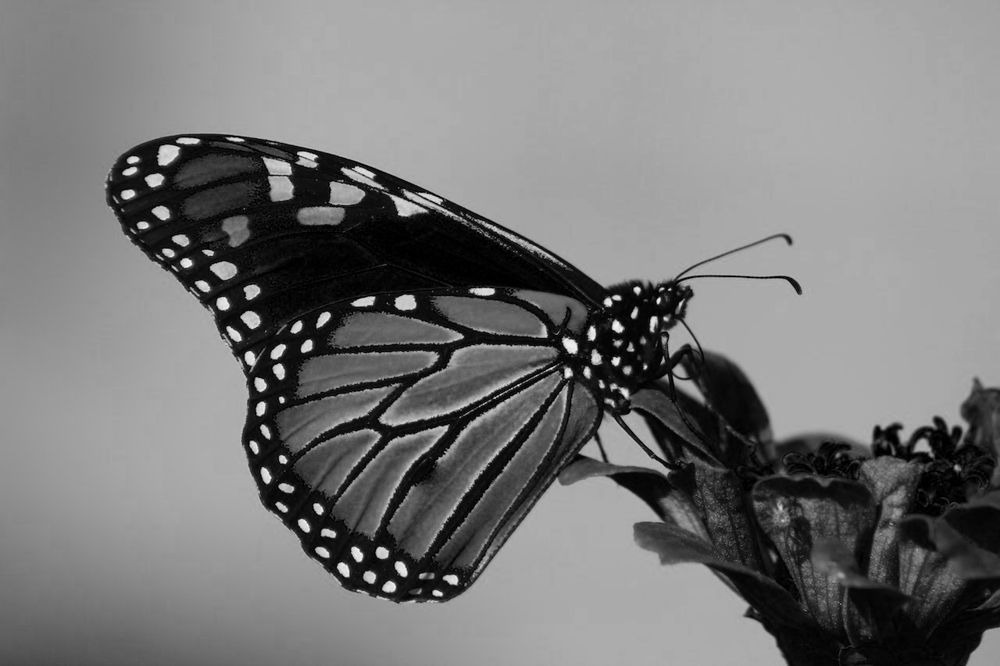

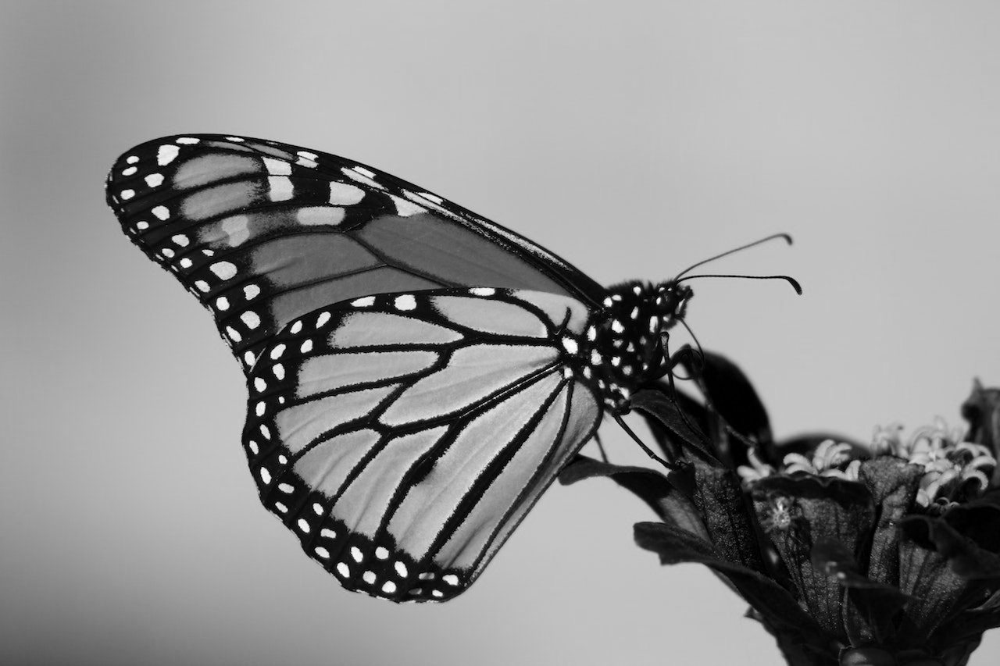

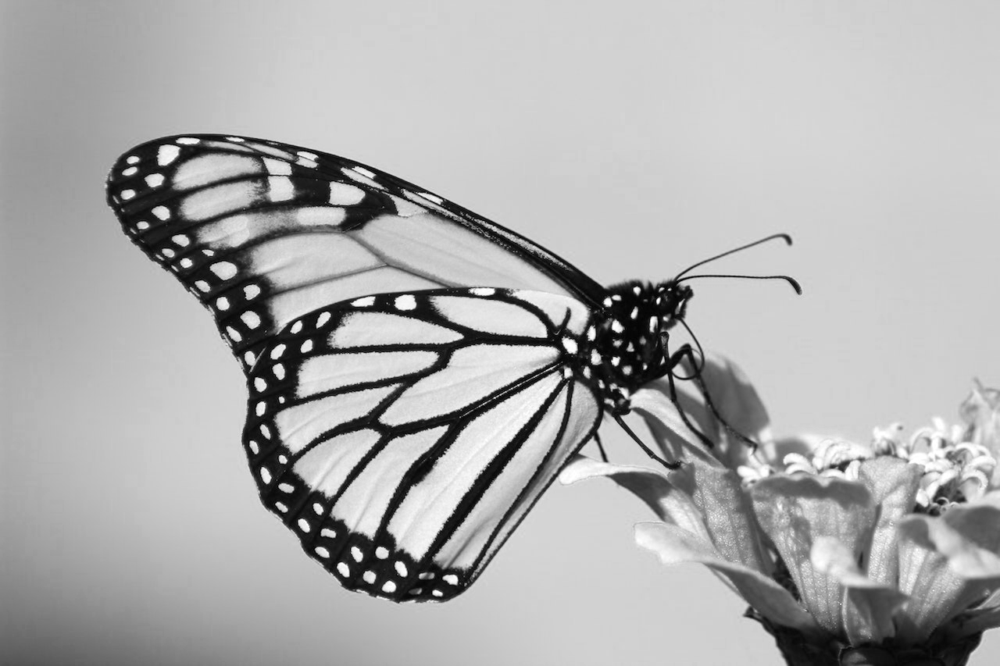

In [ ]:
b, g, r = cv2.split(image)
cv2_imshow(b)
cv2_imshow(g)
cv2_imshow(r)

**Converting the color image to gray**

---



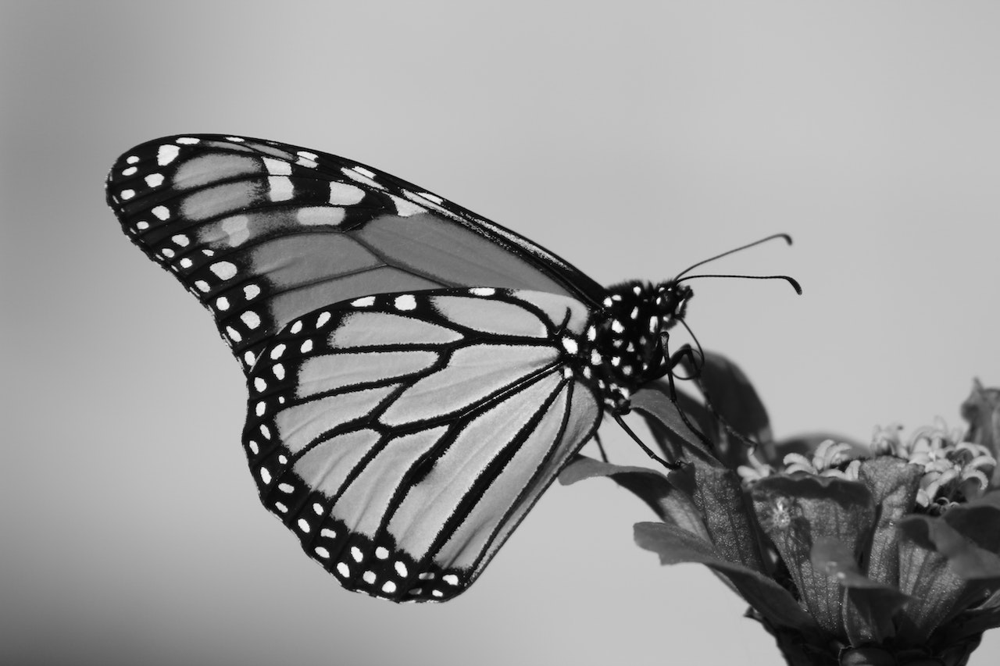

In [ ]:
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
cv2_imshow(gray_image)

**Negative of the image**

---



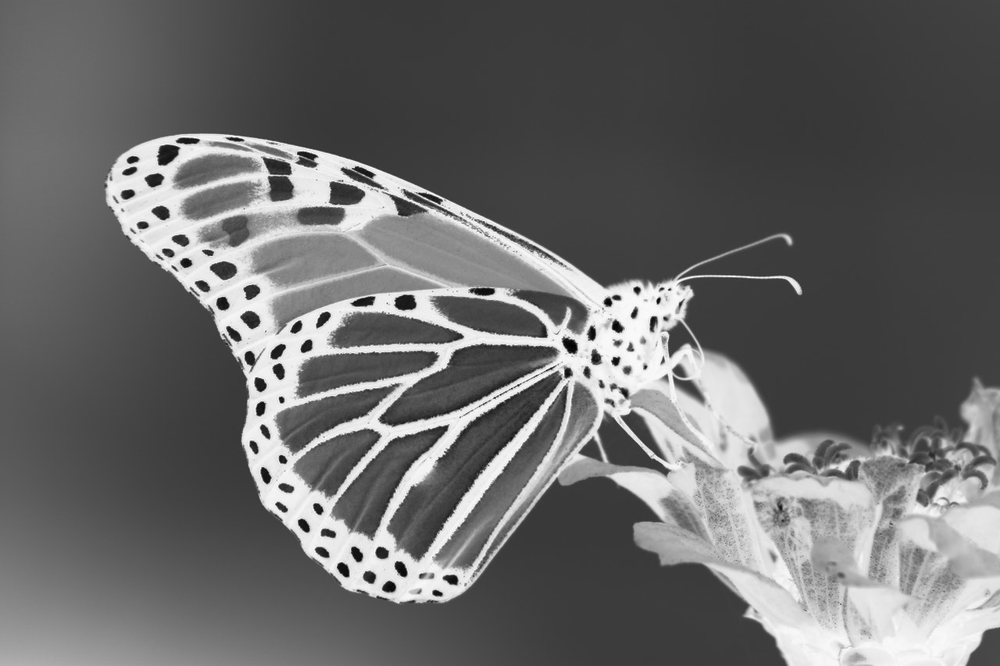

In [ ]:
negative_image = 255 - gray_image
cv2_imshow(negative_image)


**Adding 50 to each pixel**

---



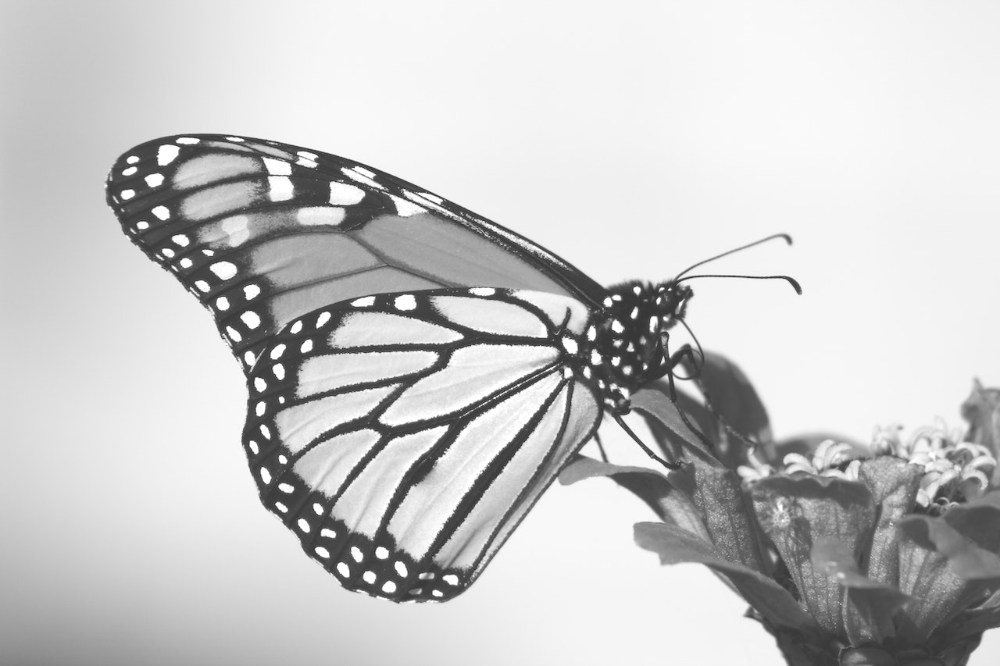

In [ ]:
add50_image = cv2.add(gray_image, 50)
cv2_imshow(add50_image)

**Scaling the Image**

---



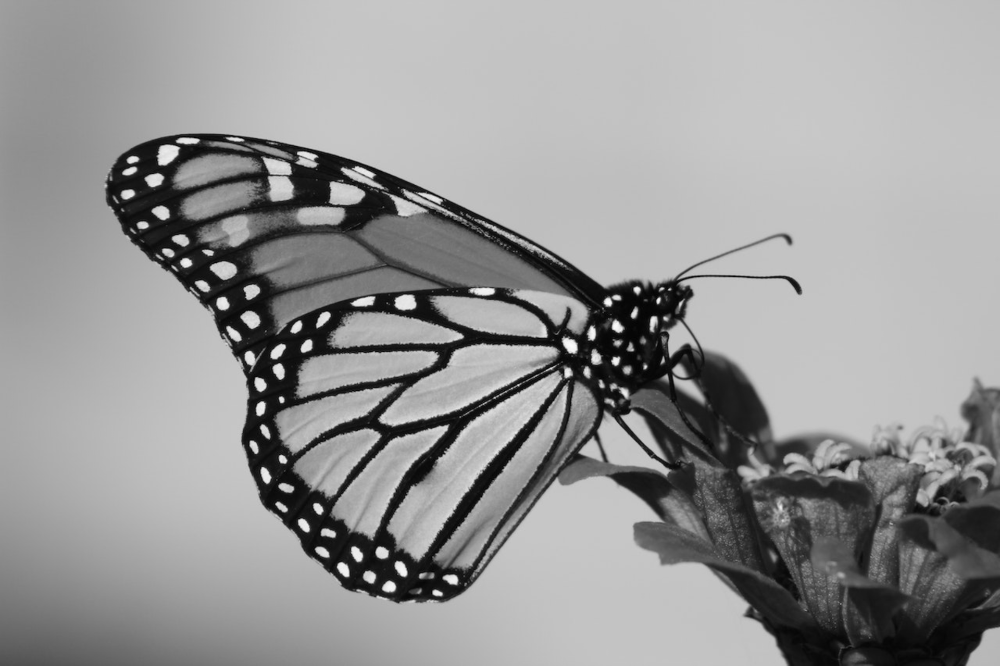

In [ ]:
scaled_image = cv2.resize(gray_image, None, fx= 1.5, fy = 1.5, interpolation=cv2.INTER_LINEAR)
cv2_imshow(scaled_image)

**Rotating the image**

---



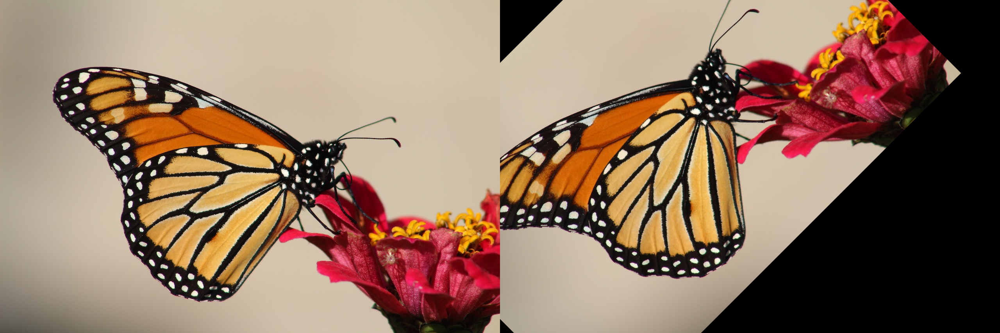

In [ ]:
import numpy as np

(height, width, channels) = image.shape
center = (height//2, width//2)
angle = 45
matrix = cv2.getRotationMatrix2D(center, angle, 1)
rotated_image = cv2.warpAffine(image, matrix, (width, height))
stacked_images = np.hstack((image, rotated_image))
cv2_imshow(stacked_images)

**Translating the Image**

---



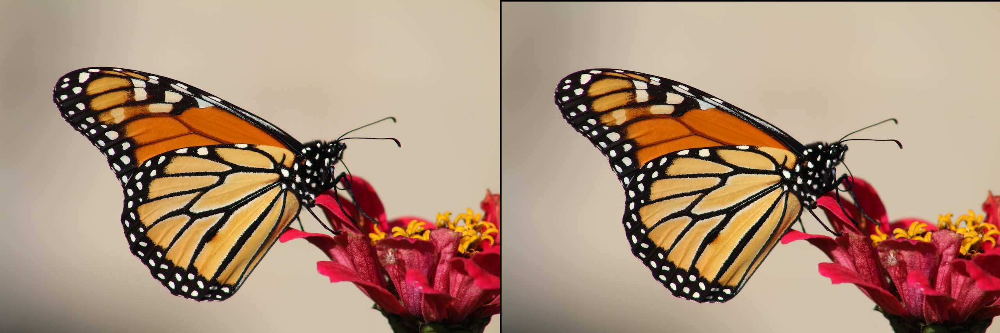

In [ ]:
tx = 4
ty = 4
matrix = np.float32([[1, 0, tx], [0, 1, ty]])
translated_image = cv2.warpAffine(image, matrix, (width, height))
stacked_images = np.hstack((image, translated_image))
cv2_imshow(stacked_images)

**Mirror Image**

---



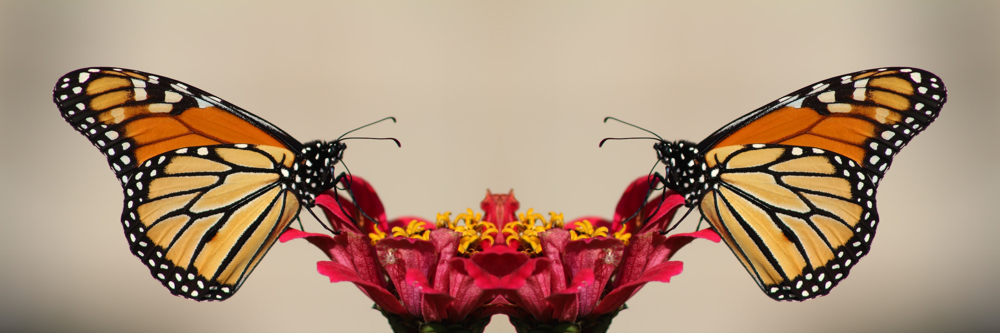

In [ ]:
mirror_image = cv2.flip(image, 1)
stacked_images = np.hstack((image, mirror_image))
cv2_imshow(stacked_images)

**Adding Guassian noise to image**

---



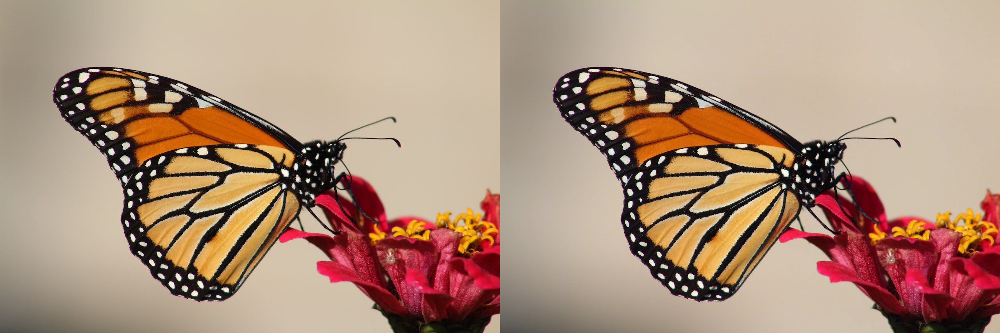

In [ ]:
noise = np.zeros(image.shape, np.uint8)
cv2.randn(noise, 0, 7)
gaussian_noisy_image = cv2.add(image, noise)
stacked_images = np.hstack((image, gaussian_noisy_image))
cv2_imshow(stacked_images)

**Adding Random noise to image**

---



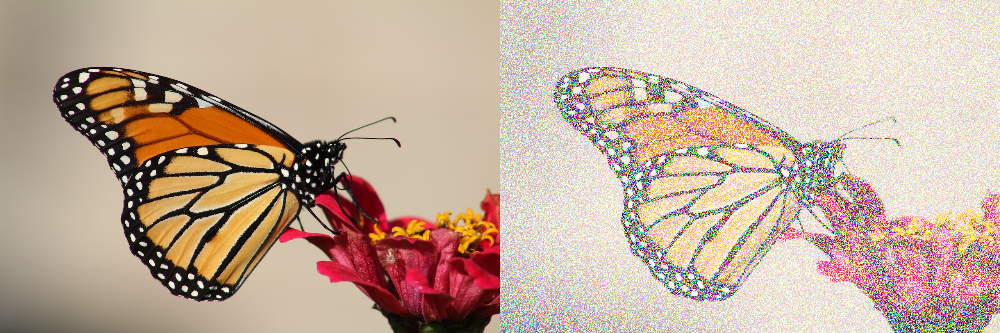

In [ ]:
random_noise = np.random.randint(-25, 25, image.shape).astype('int16')
noisy_image = cv2.add(image, random_noise.astype('uint8'))
stacked_images = np.hstack((image, noisy_image))
cv2_imshow(stacked_images)


**Guassian and Mean filtering of the guassian noise image**

---



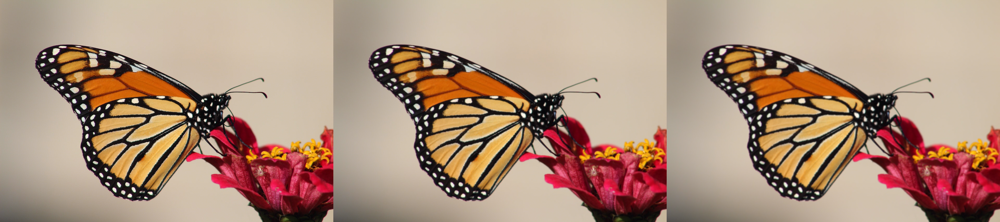

In [ ]:
gaussian_filtered_1 = cv2.GaussianBlur(gaussian_noisy_image, (5, 5), 0)
mean_filtered_1 = cv2.blur(gaussian_noisy_image, (5, 5))
stacked_images = np.hstack((gaussian_noisy_image, gaussian_filtered_1, mean_filtered_1))
cv2_imshow(stacked_images)

**Guassian and Mean filtering of the random noise image**

---



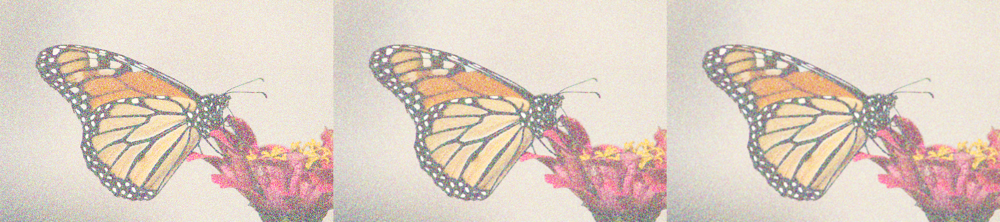

In [ ]:
gaussian_filtered_2 = cv2.GaussianBlur(noisy_image, (5, 5), 0)
mean_filtered_2 = cv2.blur(noisy_image, (5, 5))
stacked_images = np.hstack((noisy_image, gaussian_filtered_2, mean_filtered_2))
cv2_imshow(stacked_images)

**prewitt edge detector**

---



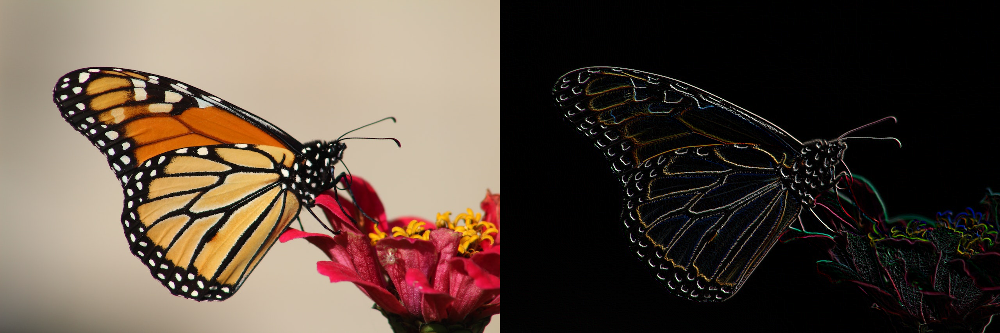

In [ ]:
kernelx = np.array([[1, 1, 1], [0, 0, 0], [-1, -1, -1]])
kernely = np.array([[-1, 0, 1], [-1, 0, 1], [-1, 0, 1]])
img_prewittx = cv2.filter2D(image, -1, kernelx)
img_prewitty = cv2.filter2D(image, -1, kernely)
img_prewitt = cv2.addWeighted(img_prewittx, 0.5, img_prewitty, 0.5, 0)
stacked_images = np.hstack((image, img_prewitt))
cv2_imshow(stacked_images)

**Sobel edge detector**

---



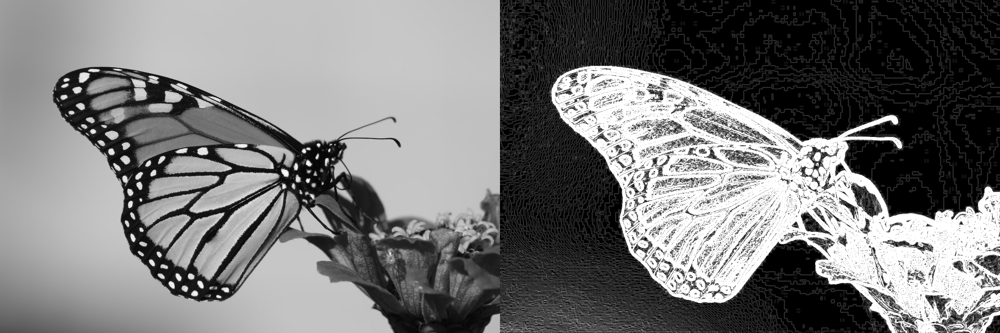

In [ ]:
sobel_x = cv2.Sobel(gray_image, cv2.CV_64F, 1, 0, ksize=5)
sobel_y = cv2.Sobel(gray_image, cv2.CV_64F, 0, 1, ksize=5)

sobel_image = cv2.magnitude(sobel_x, sobel_y)
stacked_images = np.hstack((gray_image, sobel_image))
cv2_imshow(stacked_images)

**Canny edge detector**

---



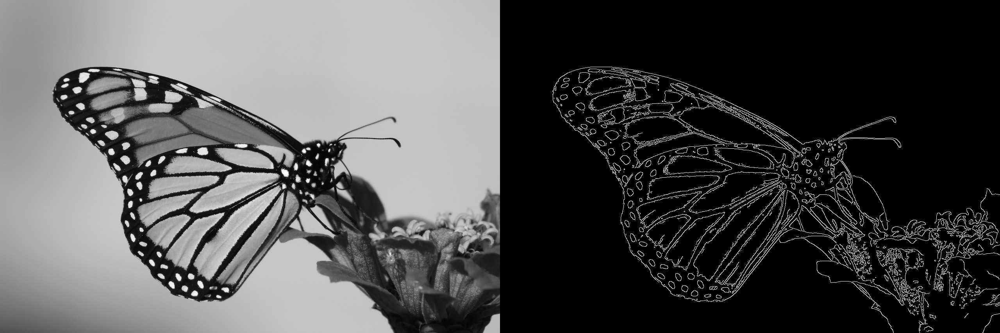

In [ ]:
canny_image = cv2.Canny(image, 100, 200)
stacked_images = np.hstack((gray_image, canny_image))
cv2_imshow(stacked_images)

**sub-band coding with haar wavelet at level 2**

---



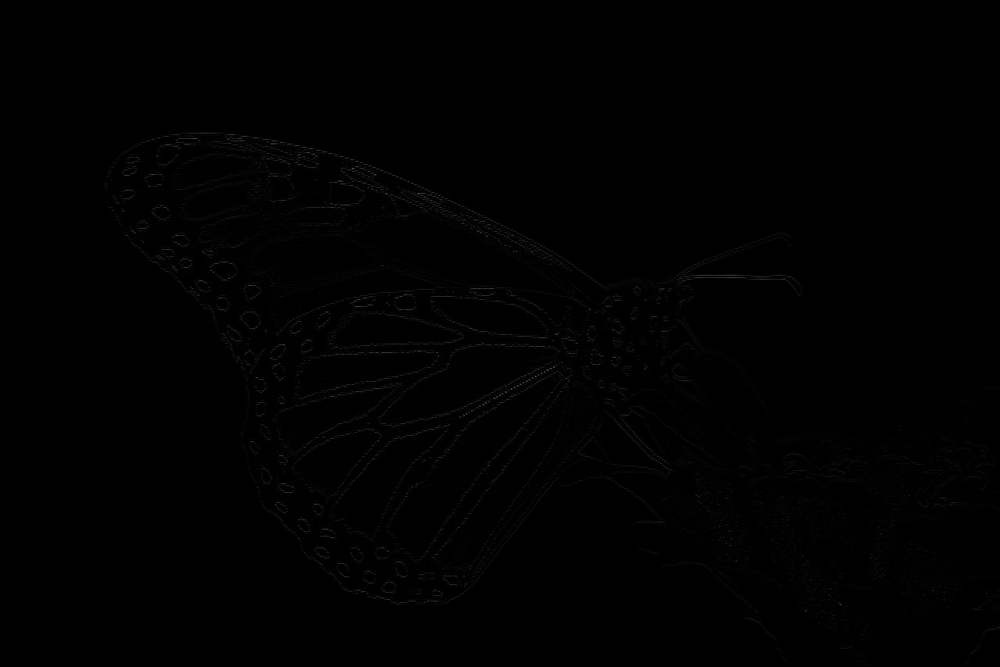

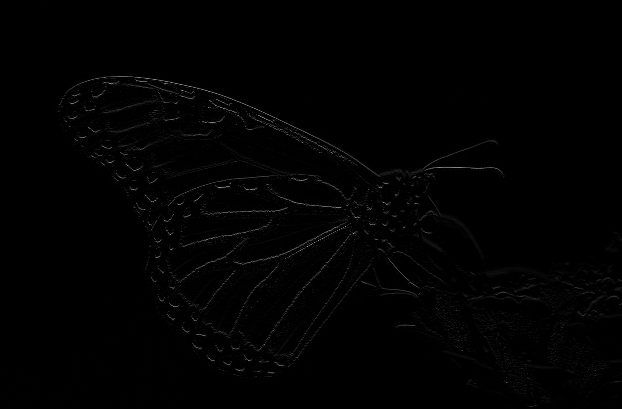

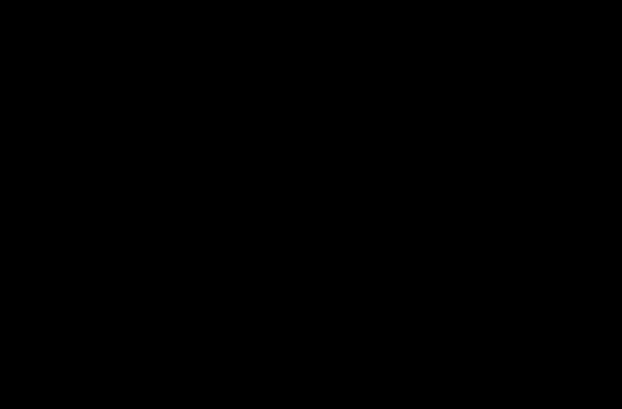

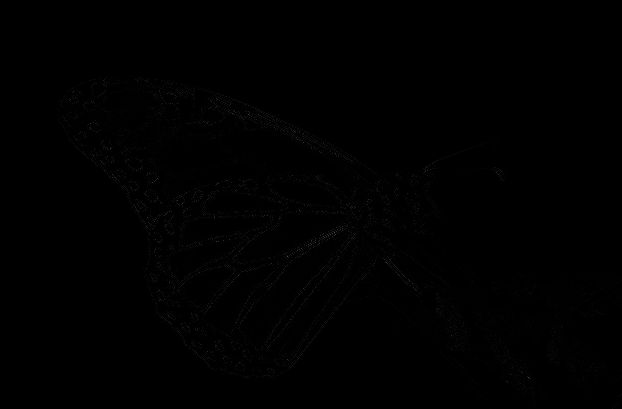

In [ ]:
import pywt

height, width = gray_image.shape
border_size = pywt.dwt_max_level(height, 'haar') * 2
padded_image = cv2.copyMakeBorder(gray_image, border_size, border_size, border_size, border_size, cv2.BORDER_REPLICATE)

# Perform 2-level Haar wavelet transform
coeffs = pywt.dwt2(padded_image, 'haar', mode='symmetric')

# Extract the sub-bands
LL, (LH, HL, HH) = coeffs

# Set the sub-bands to 0 except for the LH, HL and HH bands
LL = np.zeros_like(LL)
HL = np.zeros_like(HL)
LL_HL_HH = pywt.idwt2((LL, (LH, HL, HH)), 'haar')

# Remove the padding
subband1 = LL_HL_HH[border_size:-border_size, border_size:-border_size]
subband2 = LH[border_size:-border_size, border_size:-border_size]
subband3 = HL[border_size:-border_size, border_size:-border_size]
subband4 = HH[border_size:-border_size, border_size:-border_size]

cv2_imshow(subband1)
cv2_imshow(subband2)
cv2_imshow(subband3)
cv2_imshow(subband4)


**Construction of the gaussian pyramid upto three levels**

---



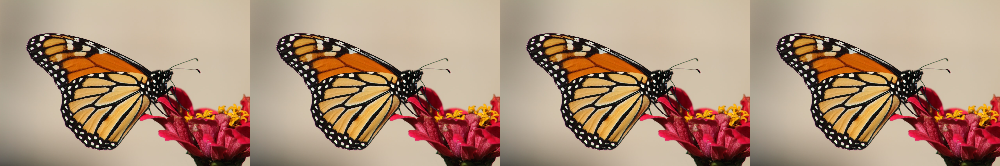

In [ ]:

# Construct Gaussian pyramid up to 3-levels
gaussian_pyr = [image]
for i in range(3):
    img = cv2.pyrDown(image)
    gaussian_pyr.append(image)



# Displaying the images
stacked_images = np.hstack((gaussian_pyr[0], gaussian_pyr[1], gaussian_pyr[2], gaussian_pyr[3]))
cv2_imshow(stacked_images)

**Reconstruction of original using Laplacian pyramids**

---



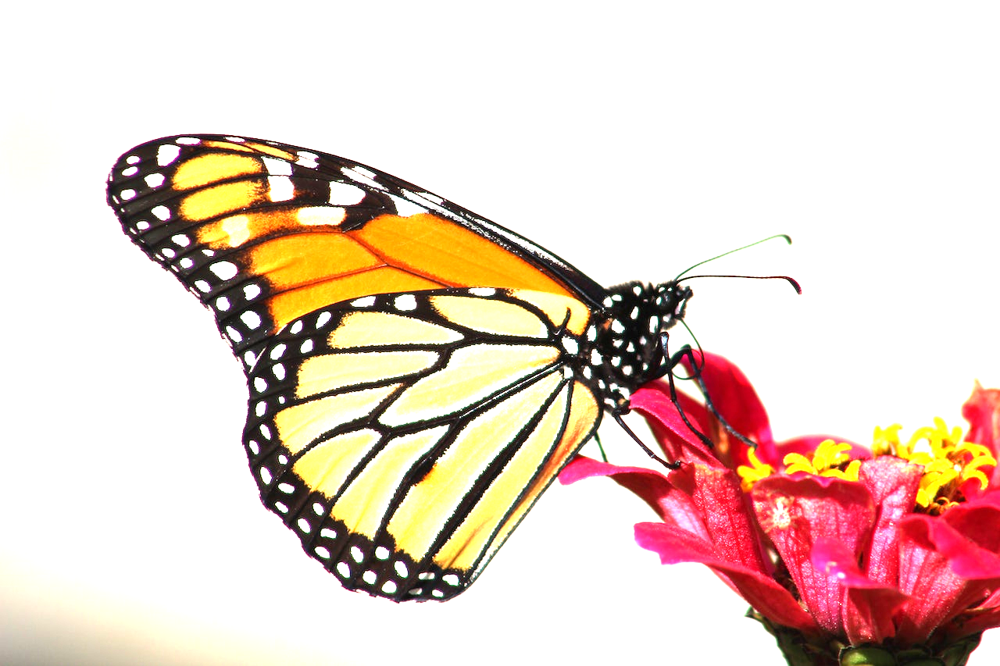

In [ ]:
# Construct Laplacian pyramid
laplacian_pyr = [gaussian_pyr[3]]
for i in range(3, 0, -1):
    img_up = cv2.pyrUp(gaussian_pyr[i])
    img_up = cv2.resize(img_up, gaussian_pyr[i-1].shape[:2][::-1])
    img_lap = cv2.subtract(gaussian_pyr[i-1], img_up)
    laplacian_pyr.append(img_lap)

# Reconstruct the original image from Laplacian pyramid
reconstructed_img = laplacian_pyr[0]
for i in range(1, 3):
    laplacian_pyr[i-1] = cv2.resize(laplacian_pyr[i-1], reconstructed_img.shape[1::-1])
    reconstructed_img = cv2.add(reconstructed_img, laplacian_pyr[i-1])

# Displaying the images
cv2_imshow(reconstructed_img)